# Proyek Akhir - Book-Crossing: User Review Ratings

---
By : Rahmi Amilia


### 1. Project Overview

Di era digital, pengguna memiliki akses ke ribuan buku melalui platform online. Namun, banyaknya pilihan justru membuat pengguna kesulitan menentukan buku yang sesuai dengan preferensi mereka. Oleh karena itu, sistem rekomendasi diperlukan untuk membantu pengguna menemukan buku yang relevan dan menarik.

Dataset Book-Crossing adalah salah satu dataset publik paling terkenal dalam domain sistem rekomendasi buku. Dataset ini berisi informasi tentang pengguna, buku, dan interaksi berupa ulasan/rating yang dapat dimanfaatkan untuk membangun sistem rekomendasi berbasis Collaborative Filtering.

### Business Understanding


### 1. IMPORT LIBRARIES

In [69]:
!pip install numpy==1.24.4

In [70]:
!pip install scikit-surprise

In [71]:
import os
import numpy as np
import pandas as pd
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split
from surprise import accuracy
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from surprise.accuracy import rmse

import seaborn as sns
import matplotlib.pyplot as plt

### 2. LOAD DATA

In [72]:
books = pd.read_csv('/content/BX_Books.csv', sep=';', encoding='latin-1', nrows=10000)
ratings = pd.read_csv('/content/BX-Book-Ratings.csv', sep=';', encoding='latin-1')
users = pd.read_csv('/content/BX-Users.csv', sep=';', encoding='latin-1')

In [73]:
print('jumlah data books : ', books.shape)
print('jumlah data ratings : ', ratings.shape)
print('jumlah data users : ', users.shape)

jumlah data books :  (10000, 8)
jumlah data ratings :  (1149780, 3)
jumlah data users :  (278858, 3)


### 3. DATA UNDERSTANDING

In [74]:
print(books.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 8 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   ISBN                 10000 non-null  object
 1   Book-Title           10000 non-null  object
 2   Book-Author          10000 non-null  object
 3   Year-Of-Publication  10000 non-null  int64 
 4   Publisher            10000 non-null  object
 5   Image-URL-S          10000 non-null  object
 6   Image-URL-M          10000 non-null  object
 7   Image-URL-L          10000 non-null  object
dtypes: int64(1), object(7)
memory usage: 625.1+ KB
None


In [75]:
print(users.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278858 entries, 0 to 278857
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   User-ID   278858 non-null  int64  
 1   Location  278858 non-null  object 
 2   Age       168096 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 6.4+ MB
None


In [76]:
print(ratings.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1149780 entries, 0 to 1149779
Data columns (total 3 columns):
 #   Column       Non-Null Count    Dtype 
---  ------       --------------    ----- 
 0   User-ID      1149780 non-null  int64 
 1   ISBN         1149780 non-null  object
 2   Book-Rating  1149780 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 26.3+ MB
None


Statistik Deskriptif

In [77]:
print("Statistik Umur Pengguna")
print(users['Age'].describe())

Statistik Umur Pengguna
count    168096.000000
mean         34.751434
std          14.428097
min           0.000000
25%          24.000000
50%          32.000000
75%          44.000000
max         244.000000
Name: Age, dtype: float64


In [78]:
print("Distribusi Rating")
print(ratings['Book-Rating'].value_counts().sort_index())

Distribusi Rating
Book-Rating
0     716109
1       1770
2       2759
3       5996
4       8904
5      50974
6      36924
7      76457
8     103736
9      67541
10     78610
Name: count, dtype: int64


Cek Missing Values

In [79]:
print("Missing Values per Dataset:")
print("Books:", books.isnull().sum())
print("\nUsers:", users.isnull().sum())
print("\nRatings:", ratings.isnull().sum())

Missing Values per Dataset:
Books: ISBN                   0
Book-Title             0
Book-Author            0
Year-Of-Publication    0
Publisher              0
Image-URL-S            0
Image-URL-M            0
Image-URL-L            0
dtype: int64

Users: User-ID          0
Location         0
Age         110762
dtype: int64

Ratings: User-ID        0
ISBN           0
Book-Rating    0
dtype: int64


### Data Preprocessing

In [80]:
books.rename(columns={
    'ISBN': 'isbn',
    'Book-Title': 'title',
    'Book-Author': 'author',
    'Year-Of-Publication': 'year',
    'Publisher': 'publisher',
    'Image-URL-S': 'img_s',
    'Image-URL-M': 'img_m',
    'Image-URL-L': 'img_l'
}, inplace=True)

print(books.describe)

<bound method NDFrame.describe of             isbn                                              title  \
0     0195153448                                Classical Mythology   
1     0002005018                                       Clara Callan   
2     0060973129                               Decision in Normandy   
3     0374157065  Flu: The Story of the Great Influenza Pandemic...   
4     0393045218                             The Mummies of Urumchi   
...          ...                                                ...   
9995  0140283404  Beloved (Penguin Great Books of the 20th Century)   
9996  0380730774  Read This and Tell Me What It Says : Stories (...   
9997  0862418879                                     The Star Rover   
9998  340414645X                                   Die Keltennadel.   
9999  3442730988                                Tod in der Datscha.   

                    author  year                publisher  \
0       Mark P. O. Morford  2002  Oxford University 

In [81]:
users.rename(columns={
    'User-ID': 'user_id',
    'Location': 'location',
    'Age': 'age'
}, inplace=True)

print(users.describe)

<bound method NDFrame.describe of         user_id                            location   age
0             1                  nyc, new york, usa   NaN
1             2           stockton, california, usa  18.0
2             3     moscow, yukon territory, russia   NaN
3             4           porto, v.n.gaia, portugal  17.0
4             5  farnborough, hants, united kingdom   NaN
...         ...                                 ...   ...
278853   278854               portland, oregon, usa   NaN
278854   278855  tacoma, washington, united kingdom  50.0
278855   278856           brampton, ontario, canada   NaN
278856   278857           knoxville, tennessee, usa   NaN
278857   278858                dublin, n/a, ireland   NaN

[278858 rows x 3 columns]>


In [82]:
ratings.rename(columns={
    'User-ID': 'user_id',
    'ISBN': 'isbn',
    'Book-Rating': 'rating'
}, inplace=True)

print(ratings.describe)

<bound method NDFrame.describe of          user_id         isbn  rating
0         276725   034545104X       0
1         276726   0155061224       5
2         276727   0446520802       0
3         276729   052165615X       3
4         276729   0521795028       6
...          ...          ...     ...
1149775   276704   1563526298       9
1149776   276706   0679447156       0
1149777   276709   0515107662      10
1149778   276721   0590442449      10
1149779   276723  05162443314       8

[1149780 rows x 3 columns]>


In [83]:
print(books.columns)
print(users.columns)
print(ratings.columns)

Index(['isbn', 'title', 'author', 'year', 'publisher', 'img_s', 'img_m',
       'img_l'],
      dtype='object')
Index(['user_id', 'location', 'age'], dtype='object')
Index(['user_id', 'isbn', 'rating'], dtype='object')


In [84]:
ratings_books = pd.merge(ratings, books, on='isbn')
print(ratings_books.head())

   user_id        isbn  rating                 title          author  year  \
0   276725  034545104X       0  Flesh Tones: A Novel      M. J. Rose  2002   
1   276744  038550120X       7       A Painted House    JOHN GRISHAM  2001   
2   276746  0425115801       0             Lightning  Dean R. Koontz  1996   
3   276746  0449006522       0   Manhattan Hunt Club       JOHN SAUL  2002   
4   276746  0553561618       0         Dark Paradise       TAMI HOAG  1994   

                  publisher  \
0          Ballantine Books   
1                 Doubleday   
2  Berkley Publishing Group   
3          Ballantine Books   
4                    Bantam   

                                               img_s  \
0  http://images.amazon.com/images/P/034545104X.0...   
1  http://images.amazon.com/images/P/038550120X.0...   
2  http://images.amazon.com/images/P/0425115801.0...   
3  http://images.amazon.com/images/P/0449006522.0...   
4  http://images.amazon.com/images/P/0553561618.0...   

       

In [85]:
ratings_books_users = pd.merge(ratings_books, users, on='user_id')
print(ratings_books_users.head())

   user_id        isbn  rating                 title          author  year  \
0   276725  034545104X       0  Flesh Tones: A Novel      M. J. Rose  2002   
1   276744  038550120X       7       A Painted House    JOHN GRISHAM  2001   
2   276746  0425115801       0             Lightning  Dean R. Koontz  1996   
3   276746  0449006522       0   Manhattan Hunt Club       JOHN SAUL  2002   
4   276746  0553561618       0         Dark Paradise       TAMI HOAG  1994   

                  publisher  \
0          Ballantine Books   
1                 Doubleday   
2  Berkley Publishing Group   
3          Ballantine Books   
4                    Bantam   

                                               img_s  \
0  http://images.amazon.com/images/P/034545104X.0...   
1  http://images.amazon.com/images/P/038550120X.0...   
2  http://images.amazon.com/images/P/0425115801.0...   
3  http://images.amazon.com/images/P/0449006522.0...   
4  http://images.amazon.com/images/P/0553561618.0...   

       

In [86]:
print(ratings_books_users.info())
print(ratings_books_users.shape)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 268454 entries, 0 to 268453
Data columns (total 12 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   user_id    268454 non-null  int64  
 1   isbn       268454 non-null  object 
 2   rating     268454 non-null  int64  
 3   title      268454 non-null  object 
 4   author     268454 non-null  object 
 5   year       268454 non-null  int64  
 6   publisher  268454 non-null  object 
 7   img_s      268454 non-null  object 
 8   img_m      268454 non-null  object 
 9   img_l      268454 non-null  object 
 10  location   268454 non-null  object 
 11  age        191598 non-null  float64
dtypes: float64(1), int64(3), object(8)
memory usage: 24.6+ MB
None
(268454, 12)


Missing Value

In [87]:
books.isnull().sum()

,0
isbn,0
title,0
author,0
year,0
publisher,0
img_s,0
img_m,0
img_l,0


### Data Preparation

In [88]:
books.isnull().sum()
ratings.isnull().sum()

,0
user_id,0
isbn,0
rating,0


In [89]:
books = books.dropna()

In [90]:
# Hapus duplikat berdasarkan ISBN
books = books.drop_duplicates(subset='isbn')

# Filter tahun terbit tidak logis
books = books[(books['year'] >= 1900) & (books['year'] <= 2025)]

# Hapus kolom gambar jika ada
books = books.drop(columns=['img_s', 'img_m', 'img_l'], errors='ignore')


In [91]:
display(books.head())
display(books.info())
print(books.isnull().sum())

,isbn,title,author,year,publisher
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton & Company


<class 'pandas.core.frame.DataFrame'>
Index: 9815 entries, 0 to 9999
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   isbn       9815 non-null   object
 1   title      9815 non-null   object
 2   author     9815 non-null   object
 3   year       9815 non-null   int64 
 4   publisher  9815 non-null   object
dtypes: int64(1), object(4)
memory usage: 460.1+ KB


None

isbn         0
title        0
author       0
year         0
publisher    0
dtype: int64


In [92]:
display(users.head())
display(users.info())
print(users.isnull().sum())

,user_id,location,age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278858 entries, 0 to 278857
Data columns (total 3 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   user_id   278858 non-null  int64  
 1   location  278858 non-null  object 
 2   age       168096 non-null  float64
dtypes: float64(1), int64(1), object(1)
memory usage: 6.4+ MB


None

user_id          0
location         0
age         110762
dtype: int64


In [93]:
display(ratings.head())
display(ratings.info())

,user_id,isbn,rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1149780 entries, 0 to 1149779
Data columns (total 3 columns):
 #   Column   Non-Null Count    Dtype 
---  ------   --------------    ----- 
 0   user_id  1149780 non-null  int64 
 1   isbn     1149780 non-null  object
 2   rating   1149780 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 26.3+ MB


None

In [94]:
print(ratings.isnull().sum())

user_id    0
isbn       0
rating     0
dtype: int64


### 4. EDA

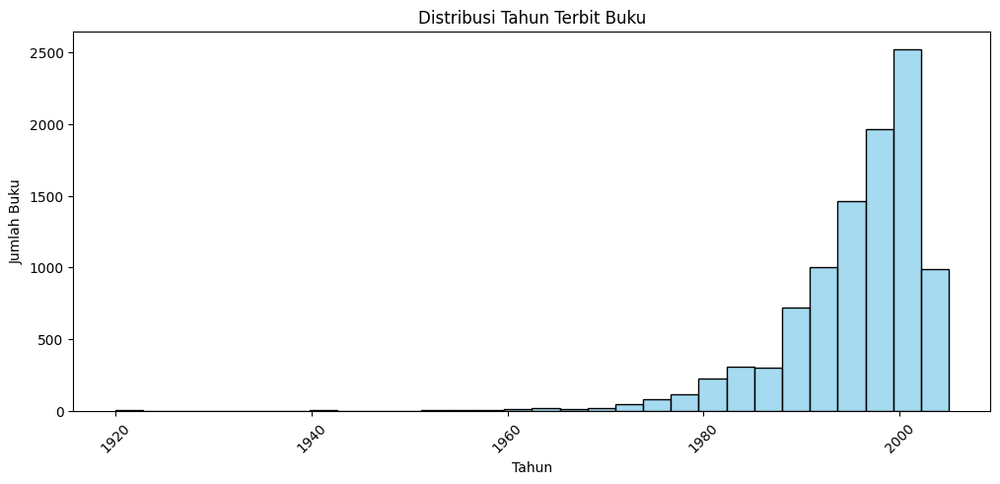

In [95]:
plt.figure(figsize=(12, 5))
sns.histplot(data=books, x='year', bins=30, kde=False, color='skyblue')
plt.title('Distribusi Tahun Terbit Buku')
plt.xlabel('Tahun')
plt.ylabel('Jumlah Buku')
plt.xticks(rotation=45)
plt.show()

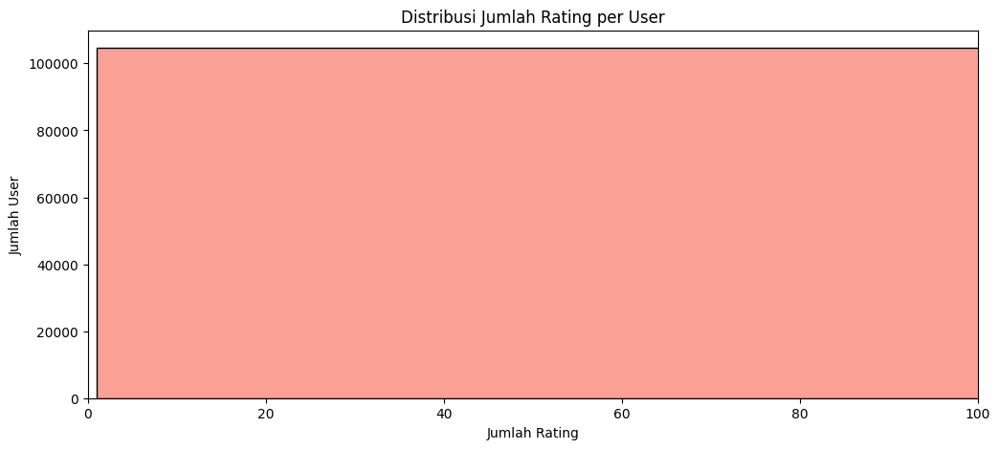

In [96]:
plt.figure(figsize=(12, 5))
user_rating_counts = ratings['user_id'].value_counts()
sns.histplot(user_rating_counts, bins=50, color='salmon')
plt.title('Distribusi Jumlah Rating per User')
plt.xlabel('Jumlah Rating')
plt.ylabel('Jumlah User')
plt.xlim(0, 100)
plt.show()

<ipython-input-97-f3c2c85fba27>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=ratings, x='rating', palette='pastel')


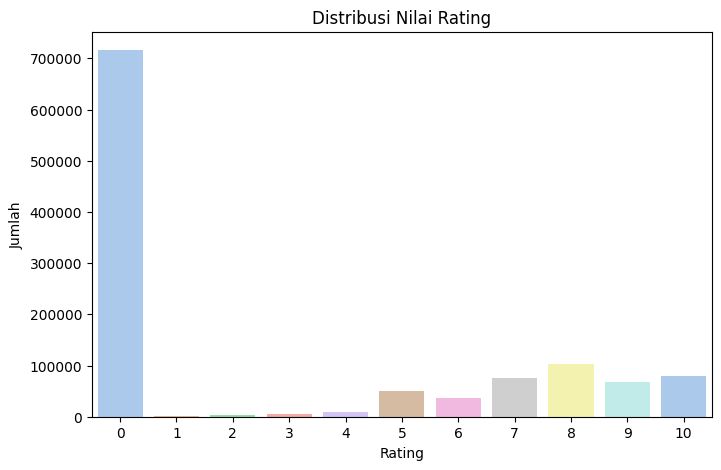

In [97]:
plt.figure(figsize=(8, 5))
sns.countplot(data=ratings, x='rating', palette='pastel')
plt.title('Distribusi Nilai Rating')
plt.xlabel('Rating')
plt.ylabel('Jumlah')
plt.show()

### 7. MODELING - SVD

### Cosine Similarity

In [98]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

books['content'] = books['title'] + ' ' + books['author'] + ' ' + books['publisher']

tfidf = TfidfVectorizer(stop_words='english')
tfidf_matrix = tfidf.fit_transform(books['content'].fillna(''))

cosine_sim = cosine_similarity(tfidf_matrix, tfidf_matrix)

indices = pd.Series(books.index, index=books['title']).drop_duplicates()

In [99]:
def content_based_recommendation(title, top_n=5):
    if title not in indices:
        return "Judul tidak ditemukan."
    idx = indices[title]
    sim_scores = list(enumerate(cosine_sim[idx]))
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)[1:top_n+1]
    book_indices = [i[0] for i in sim_scores]
    return books.iloc[book_indices][['title', 'author', 'publisher']]

content_based_recommendation("Classical Mythology")

,title,author,publisher
5280,The Mill on the Floss (Oxford World's Classics),George Eliot,Oxford University Press
6972,Dracula (Oxford World's Classics),Bram Stoker,Oxford University Press
6383,Prince Among Slaves (Oxford Paperbacks),Terry Alford,Oxford University Press
7506,Miss Julie and Other Plays (Oxford World's Cla...,August Strindberg,Oxford University Press
6471,Washington Square (World's Classics),Henry James,Oxford University Press


### Training Model SVD

In [100]:
reader = Reader(rating_scale=(0, 10))
data = Dataset.load_from_df(ratings[['user_id', 'isbn', 'rating']], reader)

In [101]:
trainset, testset = train_test_split(data, test_size=0.2, random_state=42)

In [102]:
model = SVD()
model.fit(trainset)

predictions = model.test(testset)
print("RMSE:", accuracy.rmse(predictions))

RMSE: 3.4995
RMSE: 3.4995090237189603


In [103]:
def get_top_n_recommendations(user_id, books_df, model, n=5):
    user_read_books = ratings[ratings['user_id'] == user_id]['isbn']
    books_not_rated = books_df[~books_df['isbn'].isin(user_read_books)]

    predictions = [model.predict(user_id, isbn) for isbn in books_not_rated['isbn']]

    predictions.sort(key=lambda x: x.est, reverse=True)

    top_books = [pred.iid for pred in predictions[:n]]
    return books_df[books_df['isbn'].isin(top_books)][['title', 'author', 'publisher']]

In [104]:
get_top_n_recommendations(user_id=276725, books_df=books, model=model, n=5)

,title,author,publisher
1485,Bel Canto: A Novel,Ann Patchett,Perennial
2809,Harry Potter and the Sorcerer's Stone (Book 1),J. K. Rowling,Scholastic
3028,Free,Paul Vincent,Upfront Publishing
4466,Love You Forever,Robert N. Munsch,Firefly Books Ltd
5431,Harry Potter and the Goblet of Fire (Book 4),J. K. Rowling,Scholastic


In [105]:
from collections import defaultdict

def get_top_n(predictions, n=10, threshold=7.0):
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        if est >= threshold:
            top_n[uid].append((iid, est))
    for uid, user_ratings in top_n.items():
        top_n[uid] = sorted(user_ratings, key=lambda x: x[1], reverse=True)[:n]
    return top_n

In [106]:
def precision_recall_at_k(predictions, k=10, threshold=7.0):
    user_est_true = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        user_est_true[uid].append((est, true_r))

    precisions, recalls = [], []

    for uid, user_ratings in user_est_true.items():
        user_ratings.sort(key=lambda x: x[0], reverse=True)
        top_k = user_ratings[:k]

        n_rel = sum((true_r >= threshold) for (_, true_r) in user_ratings)
        n_rec_k = sum((est >= threshold) for (est, _) in top_k)
        n_rel_and_rec_k = sum(((true_r >= threshold) and (est >= threshold)) for (est, true_r) in top_k)

        precision = n_rel_and_rec_k / n_rec_k if n_rec_k else 0
        recall = n_rel_and_rec_k / n_rel if n_rel else 0

        precisions.append(precision)
        recalls.append(recall)

    return np.mean(precisions), np.mean(recalls)

precision, recall = precision_recall_at_k(predictions, k=5, threshold=7.0)
print(f'Precision@5: {precision:.4f}, Recall@5: {recall:.4f}')


Precision@5: 0.0249, Recall@5: 0.0087


### 5. DATA PREPROCESSING

In [107]:
user_ids = ratings.user_id.unique().tolist()
user_to_user_encoded = {x: i for i, x in enumerate(user_ids)}
user_encoded_to_user = {i: x for i, x in enumerate(user_ids)}


In [108]:
print(user_ids)
print(user_to_user_encoded)
print(user_encoded_to_user)

[276725, 276726, 276727, 276729, 276733, 276736, 276737, 276744, 276745, 276746, 276747, 276748, 276751, 276754, 276755, 276760, 276762, 276765, 276768, 276772, 276774, 276780, 276786, 276788, 276796, 276798, 276800, 276803, 276804, 276806, 276808, 276811, 276812, 276813, 276814, 276817, 276820, 276822, 276827, 276828, 276830, 276832, 276833, 276835, 276837, 276838, 276840, 276842, 276847, 276848, 276850, 276852, 276853, 276854, 276856, 276857, 276859, 276861, 276862, 276863, 276866, 276869, 276870, 276872, 276873, 276875, 276878, 276879, 276884, 276887, 276888, 276889, 276890, 276896, 276904, 276905, 276911, 276912, 276915, 276916, 276925, 276927, 276928, 276929, 276934, 276936, 276939, 276943, 276946, 276949, 276950, 276953, 276954, 276957, 276959, 276963, 276964, 276965, 276975, 276981, 276984, 276986, 276988, 276989, 276990, 276992, 276994, 276997, 276998, 277002, 277007, 277009, 277010, 277012, 277018, 277019, 277022, 277023, 277028, 277031, 277032, 277035, 277036, 277040, 277042,

In [109]:
book_ids = ratings.isbn.unique().tolist()
book_to_book_encoded = {x: i for i, x in enumerate(book_ids)}
book_encoded_to_book = {i: x for i, x in enumerate(book_ids)}

In [110]:
print(book_ids)
print(book_to_book_encoded)
print(book_encoded_to_book)

['034545104X', '0155061224', '0446520802', '052165615X', '0521795028', '2080674722', '3257224281', '0600570967', '038550120X', '342310538', '0425115801', '0449006522', '0553561618', '055356451X', '0786013990', '0786014512', '0060517794', '0451192001', '0609801279', '0671537458', '0679776818', '0943066433', '1570231028', '1885408226', '0747558167', '3442437407', '033390804X', '3596218098', '0684867621', '0451166892', '8440682697', '034544003X', '0380000059', '0380711524', '0451167317', '0451454952', '0843920262', '3404122879', '3404182928', '3404611306', '342662429', '3426690179', '3442424216', '3442425573', '3453092007', '3453157745', '3453176944', '3453185137', '3453185323', '3453213025', '3453877241', '3492226604', '3517017442', '3596125006', 'B0000BLD7X', 'N3453124715', '9029716894', '9057868059', '0140279091', '0553572369', '0571058086', '3499230933', '3596151465', '0099543818', '3404147723', '3423111321', '3442136644', '3492232000', '8434811634', '8484330478', '8484332039', '28643

In [111]:
ratings['user'] = ratings.user_id.map(user_to_user_encoded)
ratings['book'] = ratings.isbn.map(book_to_book_encoded)

In [112]:
num_users = len(user_encoded_to_user)
num_books = len(book_encoded_to_book)
print(num_users)
print(num_books)

min_ratings = ratings['rating'].min()
max_ratings = ratings['rating'].max()

print(f'Number of User: {num_users}, Number of Books: {num_books}, Min Rating: {min_ratings}, Max Rating: {max_ratings}')


105283
340556
Number of User: 105283, Number of Books: 340556, Min Rating: 0, Max Rating: 10


In [113]:
reader = Reader(rating_scale=(0, 10))

data = Dataset.load_from_df(ratings[['user_id', 'isbn', 'rating']], reader)

trainset, testset = train_test_split(data, test_size=0.2, random_state=42)

model = SVD()
model.fit(trainset)

predictions = model.test(testset)
rmse(predictions)

RMSE: 3.5033


3.503334558576133

In [114]:
def get_top_n_recommendations(model, user_id, books_df, ratings_df, n=10):
    buku_yang_belum_dinilai = books_df[~books_df['isbn'].isin(
        ratings_df[ratings_df['user_id'] == user_id]['isbn']
    )]

    buku_yang_belum_dinilai['est_rating'] = buku_yang_belum_dinilai['isbn'].apply(
        lambda x: model.predict(user_id, x).est
    )

    return buku_yang_belum_dinilai.sort_values('est_rating', ascending=False)[['title', 'est_rating']].head(n)

top_books = get_top_n_recommendations(model, user_id=276729, books_df=books, ratings_df=ratings)
print(top_books)


                                                  title  est_rating
3028                                               Free    7.545600
1102                            Interpreter of Maladies    6.323060
3839  Harry Potter and the Prisoner of Azkaban (Book 3)    6.247434
1101       Where the Sidewalk Ends : Poems and Drawings    6.147536
2809     Harry Potter and the Sorcerer's Stone (Book 1)    6.071904
3687       Daughter of the Blood (Black Jewels Trilogy)    6.066799
9580  Tuesdays with Morrie: An Old Man, a Young Man,...    5.945446
9922                                       Go Ask Alice    5.928549
2581                             The Greatest Discovery    5.921786
2232      Ender's Game (Ender Wiggins Saga (Paperback))    5.875103


In [115]:
import pickle

with open('model_rekomendasi_svd.pkl', 'wb') as f:
    pickle.dump(model, f)